<a href="https://colab.research.google.com/github/LangQin0422/SubmarinePosition/blob/main/AMATH482_HW1_LangQin.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# AMATH 482 Homework 1 - *Submarine*
## Lang Qin

# Environment Setup

We first connect our notebook to personal google drive.

In [ ]:
from google.colab import drive

# the following command loads up your google drive. It will promp you to give Colab access to your Gdrive
drive.mount('/content/drive')

Mounted at /content/drive


Then, we read in the given the dataset. 

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
data_path = '/content/drive/My Drive/AMATH 482/HW1/subdata.npy'

df = np.load(data_path) # huge matrix of size 262144 x 49 (columns contain flattened 3d matrix of size 64x64x64)

# Environment Preparation
### Domain Definition

**Spatial and Fourier Models Domain**

According to *HW1-Helper.ipynb*, we use $L=10$ as the length of spatial domain,
and use $N_{grid}=64$ as the number of grid points/Fourier modes in each direction.

In [ ]:
L = 10 # length of spatial domain (cube of side L = 2*10)
N_grid = 64 # number of grid points/Fourier modes in each direction

We set up the 3D frequency and spatial grid.

In [ ]:
xx = np.linspace(-L, L, N_grid+1) #spatial grid in x dir
x = xx[0:N_grid]
y = x # same grid in y,z direction
z = x

# frequency grid for one coordinate
k_grid = (2*np.pi/(2*L)) * np.linspace(-N_grid/2, N_grid/2 - 1, N_grid)
ks = np.fft.fftshift(k_grid)
kx, ky, kz = np.meshgrid(ks, ks, ks)

# generate 3D meshgrid for plotting
xv, yv, zv = np.meshgrid(x, y, z)

# Task 1: Frequency Signature

**Average the Fourier Transform**

Here we compute the Fourier transform average of $x,y,z$ dimensions over time.

In [ ]:
df_ave = np.zeros((64, 64, 64))

for i in range(49):
    curr = df[:, i].reshape(64, 64, 64)
    df_ave = np.abs(np.fft.fftn(curr)) + df_ave

df_ave = df_ave / 49

**Determine the Frequency Signature**

We find the indices of the frequency signature by locating the coordinate of the largest value.

In [ ]:
# find the coordinate
idx = np.unravel_index(df_ave.argmax(), (64, 64, 64))

# compute the frequency signature indices in the frequency space
kx_sig = kx[idx]
ky_sig = ky[idx]
kz_sig = kz[idx]

# preview the frequency signature indices
print("kx_sig: {0:.4f},  ky_sig: {1:.4f},  kz_sig: {2:.4f}".format(kx_sig, ky_sig, kz_sig))

kx_sig: 5.3407,  ky_sig: 2.1991,  kz_sig: -6.5973


**Visual Inspection**

We plot the isosurface of the averaged frequency space data.

> Note: Since only real data can be plotted, we frist normalized the data.

The isofurface plot of complete range of isovlaue $[0,1]$ is shown below.

In [ ]:
import plotly.graph_objects as go

df_norm = np.fft.fftshift(np.abs(df_ave)/np.abs(df_ave).max())
# generate values for isosurface of the 3D data 
fig_ave_data = go.Isosurface(
    x=xv.flatten(),
    y=yv.flatten(),
    z=zv.flatten(),
    value=df_norm.flatten(),
    isomin=0,
    isomax=1)

# generate plots
fig_ave = go.Figure(fig_ave_data)
fig_ave.update_layout(scene = dict(
                    xaxis_title='kx',
                    yaxis_title='ky',
                    zaxis_title='kz'),
                    width=700,
                    margin=dict(r=20, b=10, l=10, t=10))
fig_ave.show()


By observation, the isovalues of the data generally tend to be greater
0.6. We plot the isosurface plot with isovalues of the range $[0.6,0.8]$

In [ ]:
# generate values for isosurface of the 3D data 
fig_ave_data = go.Isosurface(
    x=xv.flatten(), 
    y=yv.flatten(),
    z=zv.flatten(),
    value=df_norm.flatten(),
    isomin=0.725,
    isomax=0.725)

# generate plots
fig_ave = go.Figure(fig_ave_data)
fig_ave.update_layout(scene = dict(
                    xaxis_title='kx',
                    yaxis_title='ky',
                    zaxis_title='kz'),
                    width=700,
                    margin=dict(r=20, b=10, l=10, t=10))
fig_ave.show()

Here, we plot the isosurface with isovalue equal to 0.725.

In [ ]:
# generate values for isosurface of the 3D data 
fig_ave_data = go.Isosurface(
    x=xv.flatten(), 
    y=yv.flatten(),
    z=zv.flatten(),
    value=df_norm.flatten(),
    isomin=0.85,
    isomax=1)

# generate plots
fig_ave = go.Figure(fig_ave_data)
fig_ave.update_layout(scene = dict(
                    xaxis_title='kx',
                    yaxis_title='ky',
                    zaxis_title='kz'),
                    width=700,
                    margin=dict(r=20, b=10, l=10, t=10))
fig_ave.show()

# Task 2: Submraine Path

**Define the filter**

Here we implement Gaussian filter to denoise the acoustic data.

In [ ]:
# filter bandwidth
tau = 0.2

# define the filter
filter = np.exp(-tau*((kx - kx_sig)**2 + (ky - ky_sig)**2 + (kz - kz_sig)**2))

**Denoise and Position**

We apply the filter to each time step and extract the spacial coordinate
of the submarine.

> Note: By the definition of ```numpy.reshape()```, we need to flip the $y,z$
inroder to obtain the corret 3D spacial coordinate.

In [ ]:
# initialize coordinates storage
coordinates = np.zeros((49, 3))

for i in range(49):
    # extract acoustic data per time step
    curr = df[:, i].reshape(64, 64, 64)

    # take fft of the noisy data
    curr_noisy_hat = np.fft.fftn(curr)

    # apply the filter and obtain clean data
    curr_clean = np.fft.ifftn(curr_noisy_hat * filter)

    # extract the coordinate
    index = np.unravel_index(curr_clean.argmax(), (64, 64, 64))
    coordinates[i, :] = [xv[index], zv[index], yv[index]]


Take a look at the coordinates of the time range

In [ ]:
coordinates

array([[ 3.125 ,  0.    , -7.8125],
       [ 3.125 ,  0.    , -7.8125],
       [ 3.125 ,  0.9375, -7.5   ],
       [ 2.8125,  0.9375, -6.875 ],
       [ 3.125 ,  1.25  , -6.5625],
       [ 3.125 ,  2.1875, -6.5625],
       [ 3.125 ,  2.1875, -6.25  ],
       [ 2.8125,  2.1875, -5.625 ],
       [ 2.8125,  3.125 , -5.625 ],
       [ 2.8125,  3.125 , -5.3125],
       [ 2.5   ,  3.125 , -4.6875],
       [ 2.5   ,  4.0625, -4.6875],
       [ 2.5   ,  4.0625, -4.6875],
       [ 1.875 ,  4.6875, -4.0625],
       [ 1.875 ,  4.6875, -4.0625],
       [ 1.25  ,  5.3125, -3.4375],
       [ 1.25  ,  5.3125, -3.4375],
       [ 0.625 ,  5.    , -2.8125],
       [ 0.3125,  5.    , -2.1875],
       [ 0.    ,  5.625 , -2.1875],
       [-0.625 ,  5.3125, -1.875 ],
       [-0.9375,  5.9375, -1.875 ],
       [-1.25  ,  5.9375, -1.25  ],
       [-2.1875,  6.25  , -0.9375],
       [-2.1875,  6.25  , -0.9375],
       [-2.8125,  5.9375, -0.3125],
       [-2.8125,  5.9375, -0.3125],
       [-3.4375,  5.625 ,  0

**Trajectory Visualization**

Text(0.5, 0, 'Z')

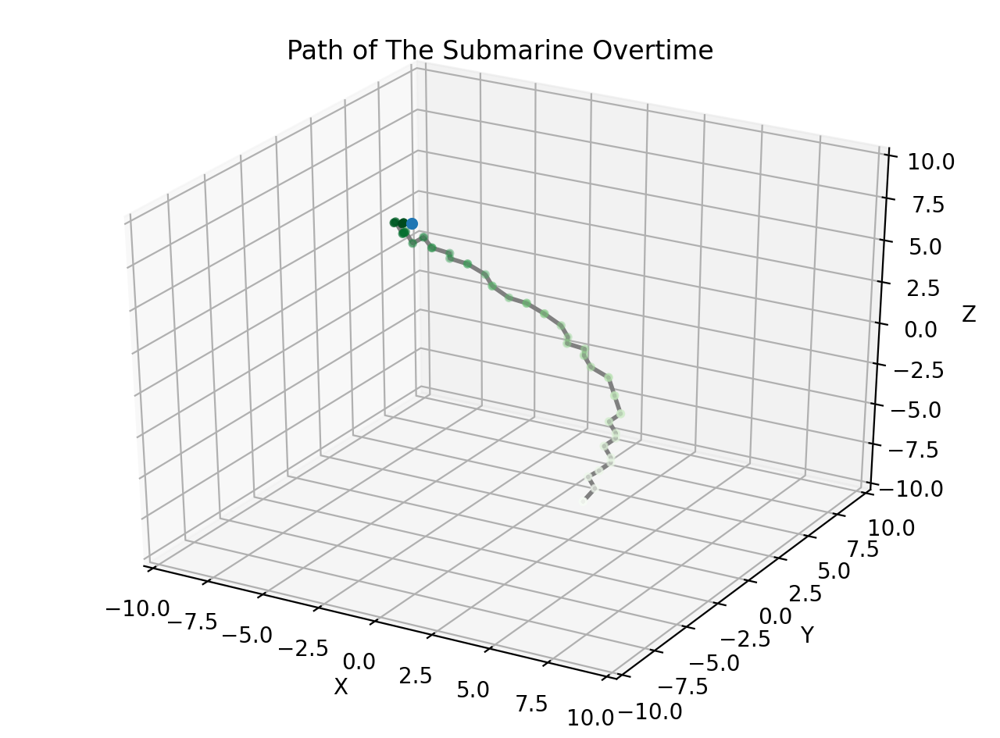

In [ ]:
from mpl_toolkits import mplot3d

fig = plt.figure(figsize=(8, 6), dpi=200)
ax = plt.axes(projection='3d')

# plot trajactory
ax.plot(coordinates[:,0], coordinates[:,1], coordinates[:,2],
        'gray', linewidth=2)

# plot the location points at each time step
ax.scatter3D(coordinates[:,0], coordinates[:,1], coordinates[:,2],
             c=coordinates[:,2], cmap='Greens', s=10)

# plot the location at the last time step
ax.scatter3D(coordinates[48,0], coordinates[48,1], coordinates[48,2])

# plot setting
ax.set_title("Path of The Submarine Overtime")

ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)
ax.set_zlim(-10, 10)

ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")


# Task 3: $x,y$ Coordinates

In this section, we determine the $x,y$ coordinates of the submarine
over the 24 hours and plot the information.

**Extract $x,y$ Coordinates**

In [ ]:
x_coordinates = coordinates[:, 0]
y_coordinates = coordinates[:, 1]

**Plot the $x,y$ Coordinates over Time**

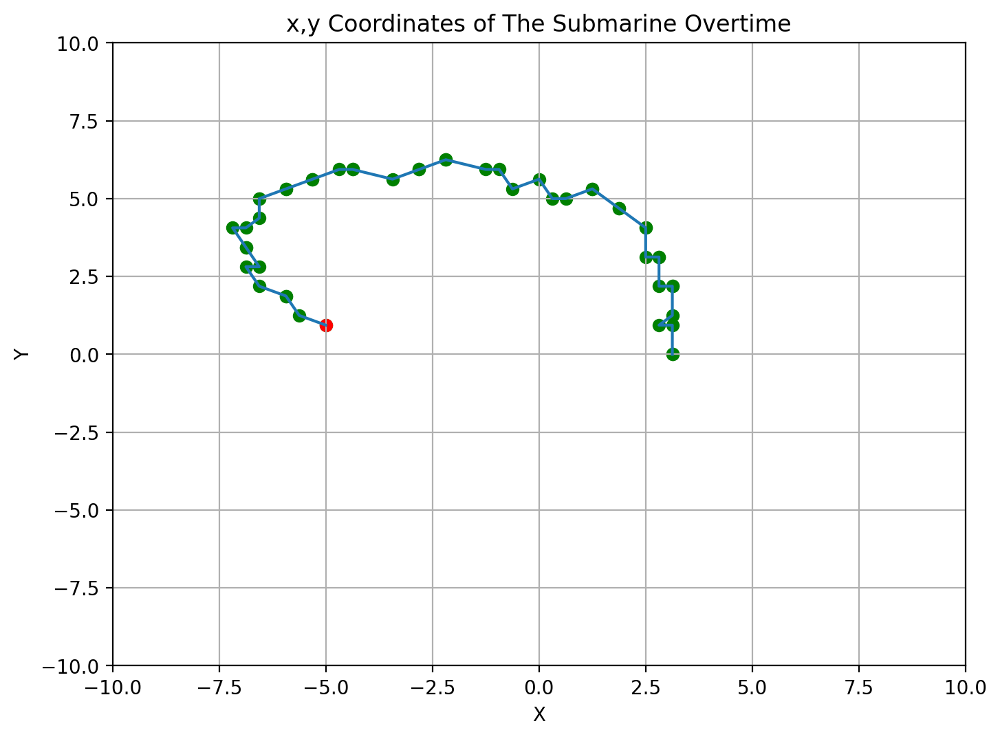

In [ ]:
fig = plt.figure(figsize=(8, 6), dpi=200)
ax = plt.axes()

# plot the x,y coordinates
ax.scatter(x_coordinates, y_coordinates, c='green')
ax.scatter(x_coordinates[48], y_coordinates[48], c='r')
ax.plot(x_coordinates, y_coordinates)

# plot setting
ax.set_title("x,y Coordinates of The Submarine Overtime")

ax.set_xlim(-10, 10)
ax.set_ylim(-10, 10)

ax.set_xlabel("X")
ax.set_ylabel("Y")

ax.grid()